In [8]:
import sys
sys.path.append('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/Codes/') 

%load_ext autoreload  
%autoreload 2         


from focus_indicator_fourier import *
from focus_indicator_laplacian import *
from utils import *
from focus_indicator_non_linear_res import *
from normalizador_defoco_por_pixel import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# Leitura das imagens
img_path = '/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned'

aligned_img_list = read_images_from_path(img_path)
aligned_img_stack = np.asarray(aligned_img_list)

/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned/align_0.jpg
/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned/align_1.jpg
/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned/align_2.jpg
/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned/align_3.jpg
/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned/align_4.jpg
/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned/align_5.jpg
/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/internet_focus_stack/imagens_3/output/align_images/aligned/align_6.jpg
/home/

# Transformada de Fourier

## Teste 1: Mascaras no dominio da frequencia

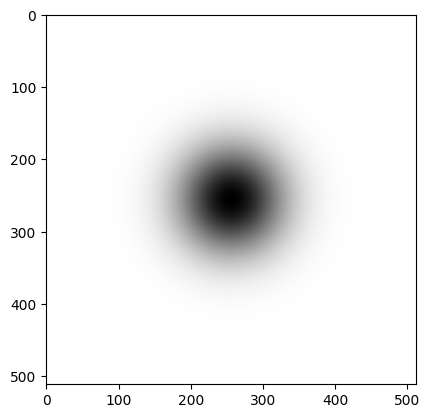

In [74]:
# testando função para calcular a mascara gaussiana eliptica
linhas = 512
colunas = 512
raio = 0.1

mascara_eliptica = mascara_eliptica_gaussiana(linhas, colunas, raio)
exibir_imagem(mascara_eliptica)

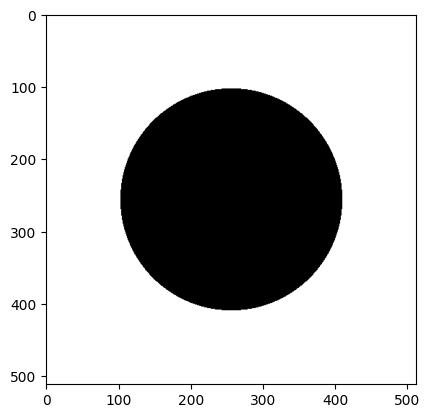

In [25]:
# testando função para calcular a mascara gaussiana eliptica
linhas = 512
colunas = 512
raio = 0.3

mascara_eliptica = mascara_eliptica_binaria(linhas, colunas, raio)
exibir_imagem(mascara_eliptica)

## Teste 2: Aplicando Fourier para diferntes mascaras

In [6]:
import cv2
import numpy as np
from utils import *
from scipy.ndimage import convolve
from math import floor, sqrt, comb, exp, log, sin, cos, pi


quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    #mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    kernel = [[1,2,1], [2,4,2], [1,2,1]]
    imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

fi_stack = fi_stack/ max_val
    
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator after normalization(fourier) max_val: {max_val}, min_val: {min_val}')


focus_img_stack_binaria = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.291713, max:0.274858, mean:0.000000, rms:0.030036, v_dev:0.030036
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.085097, mean:0.000902, rms:0.002809, v_dev:0.002660
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.256059, mean:0.010540, rms:0.020838, v_dev:0.017976
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.597979, max:0.302934, mean:0.000000, rms:0.025607, v_dev:0.025607
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.357579, mean:0.000656, rms:0.008127, v_dev:0.008101
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.033657, mean:0.001274, rms:0.002080, v_dev:0.001644
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.590352, max:0.300388, mean:0.000000, rms:0.021684, v_dev:0.021684
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.348516, mean:0.000470, rms:0.003509, v_dev:0.003477
nome:fourier: img convolucionada, shap

In [7]:
import cv2
import numpy as np
from utils import *
from scipy.ndimage import convolve
from math import floor, sqrt, comb, exp, log, sin, cos, pi


quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    kernel = [[1,2,1], [2,4,2], [1,2,1]]
    imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

fi_stack = fi_stack/ max_val
    
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator after normalization(fourier) max_val: {max_val}, min_val: {min_val}')


focus_img_stack_gaussiana = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.106239, mean:0.003797, rms:0.007648, v_dev:0.006639
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.043250, mean:0.000704, rms:0.001385, v_dev:0.001193
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

In [8]:
import cv2
import numpy as np
from utils import *
from scipy.ndimage import convolve
from math import floor, sqrt, comb, exp, log, sin, cos, pi


quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    #kernel = [[1,2,1], [2,4,2], [1,2,1]]
    #imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

fi_stack = fi_stack/ max_val
    
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator after normalization(fourier) max_val: {max_val}, min_val: {min_val}')


focus_img_stack_gaussiana_sem_borramento = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.012026, mean:0.000237, rms:0.000606, v_dev:0.000558
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.003635, mean:0.000044, rms:0.000103, v_dev:0.000093
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

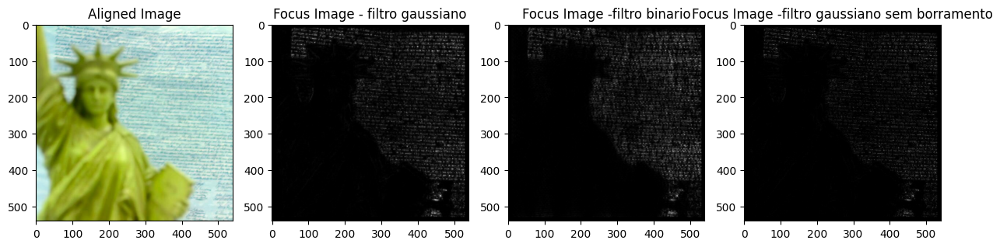

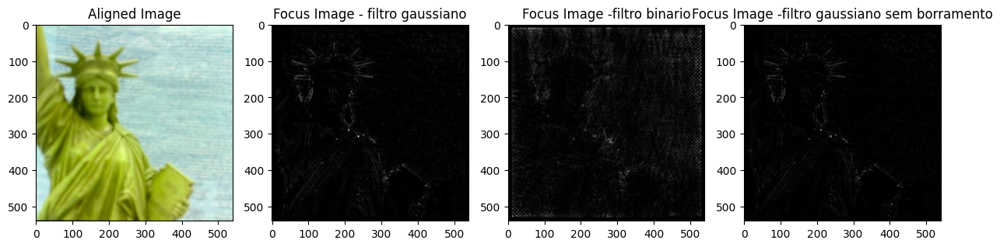

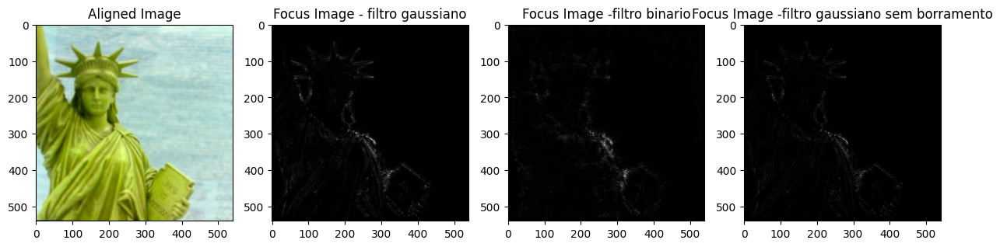

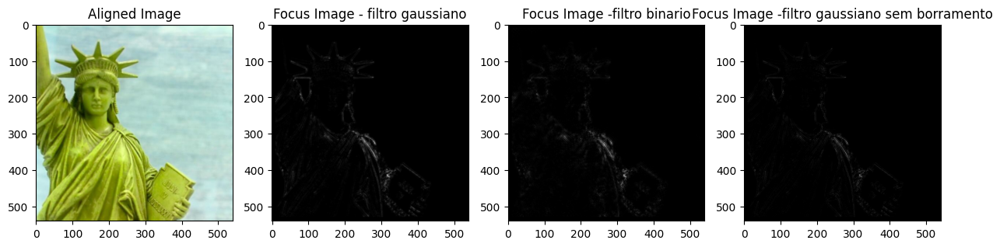

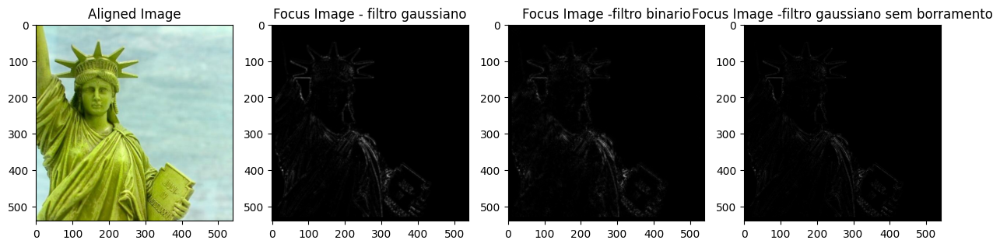

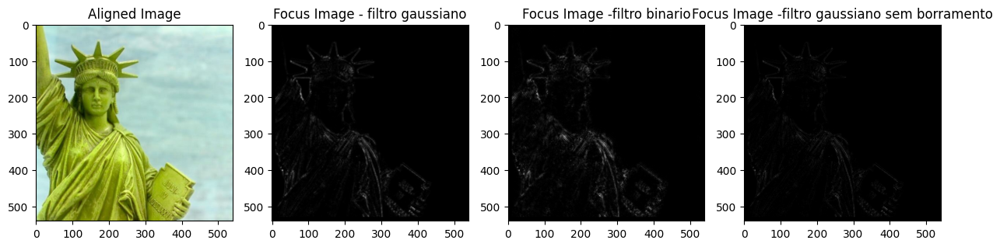

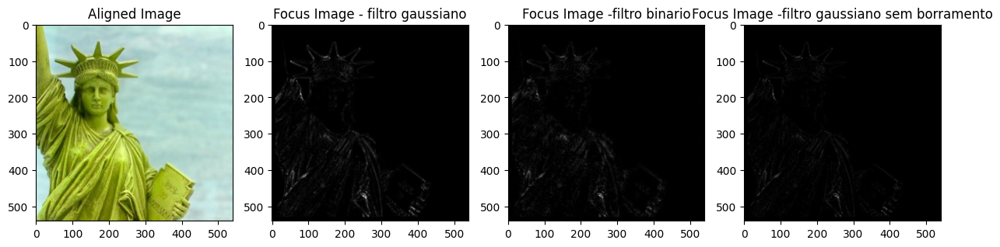

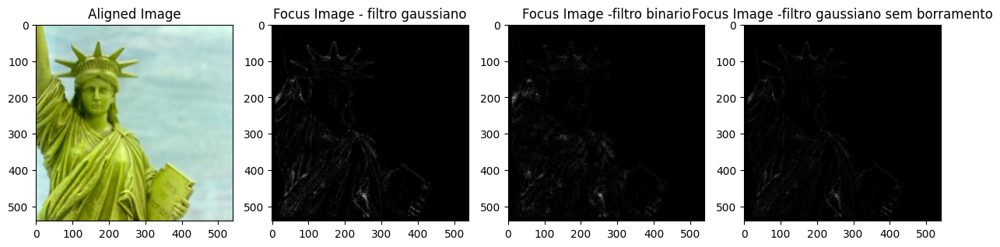

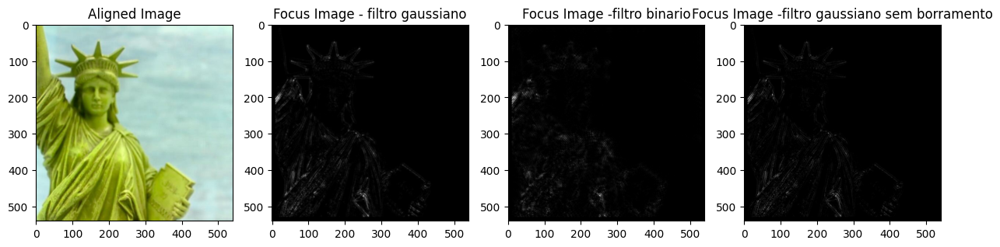

In [27]:
for i in range(aligned_img_stack.shape[0]):

    fig, axes = plt.subplots(1, 4, figsize=(15, 8))
    axes[0].imshow(aligned_img_stack[i])
    axes[0].set_title('Aligned Image')
    axes[1].imshow(focus_img_stack_gaussiana[i], cmap='gray')
    axes[1].set_title('Focus Image - filtro gaussiano')
    axes[2].imshow(focus_img_stack_binaria[i], cmap='gray')
    axes[2].set_title('Focus Image -filtro binario')
    axes[3].imshow(focus_img_stack_gaussiana_sem_borramento[i], cmap='gray')
    axes[3].set_title('Focus Image -filtro gaussiano sem borramento')
    plt.show()

## Teste 3: Testando variação dos tamanhos de filtro

In [13]:

quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    #kernel = [[1,2,1], [2,4,2], [1,2,1]]
    #imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Aplica um filtro de borramento utilizando a média ponderada
    #imagem_final = convolve(imagem_final, WEIGHTS / np.sum(WEIGHTS))
    imagem_final = cv2.filter2D(imagem_final, -1, WEIGHTS / np.sum(WEIGHTS))

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

fi_stack = fi_stack/ max_val
    
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator after normalization(fourier) max_val: {max_val}, min_val: {min_val}')


focus_img_stack_filtro_maior = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.004075, mean:0.000237, rms:0.000407, v_dev:0.000331
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.001586, mean:0.000044, rms:0.000074, v_dev:0.000059
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

In [16]:

quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    #kernel = [[1,2,1], [2,4,2], [1,2,1]]
    #imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Aplica um filtro de borramento utilizando a média ponderada
    #imagem_final = convolve(imagem_final, WEIGHTS / np.sum(WEIGHTS))
    imagem_final = cv2.filter2D(imagem_final, -1, WEIGHTS)

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

fi_stack = fi_stack/ max_val
    
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator after normalization(fourier) max_val: {max_val}, min_val: {min_val}')


focus_img_stack_filtro_maior_sem_balancear = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.330103, mean:0.019224, rms:0.032979, v_dev:0.026797
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.128459, mean:0.003566, rms:0.005991, v_dev:0.004814
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

In [18]:

quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    #kernel = [[1,2,1], [2,4,2], [1,2,1]]
    #imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Aplica um filtro de borramento utilizando a média ponderada
    imagem_final = convolve(imagem_final, WEIGHTS / np.sum(WEIGHTS))
    #imagem_final = cv2.filter2D(imagem_final, -1, WEIGHTS)

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

fi_stack = fi_stack/ max_val
    
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator after normalization(fourier) max_val: {max_val}, min_val: {min_val}')


focus_img_stack_filtro_maior_convolve = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.004075, mean:0.000237, rms:0.000407, v_dev:0.000331
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.001586, mean:0.000044, rms:0.000074, v_dev:0.000059
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

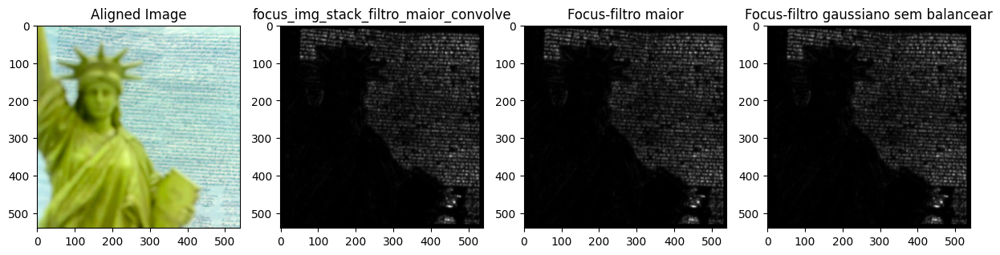

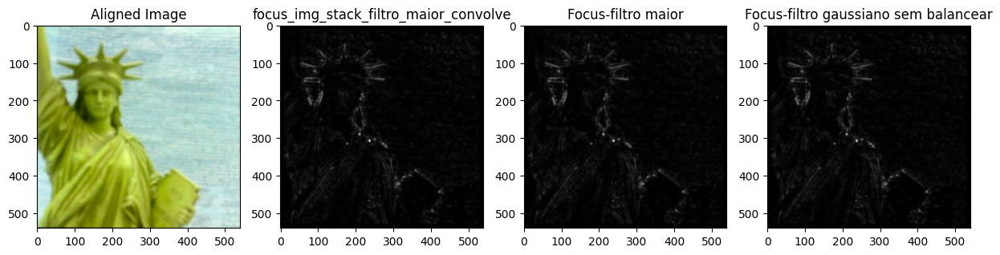

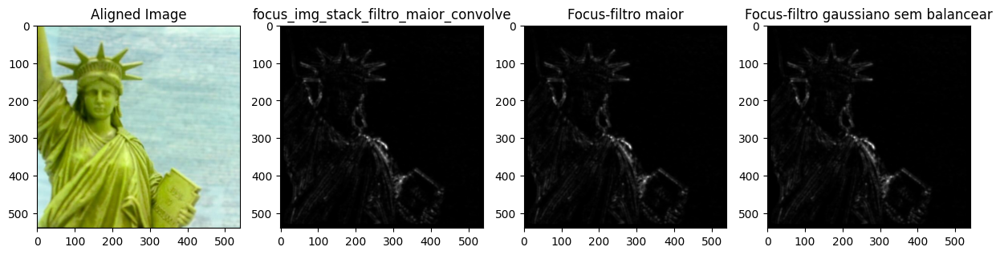

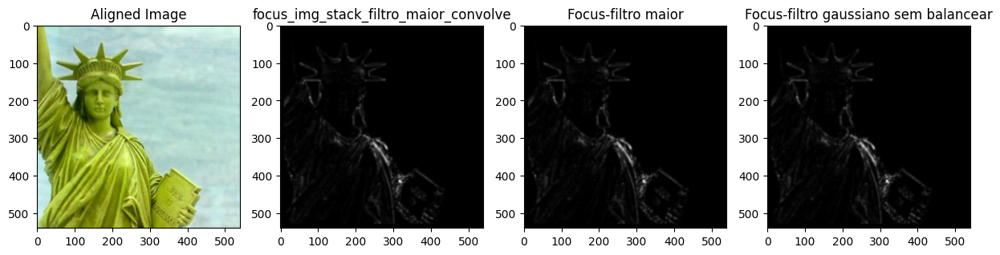

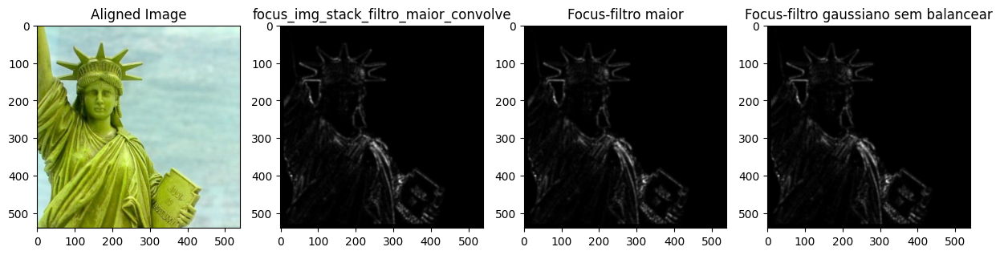

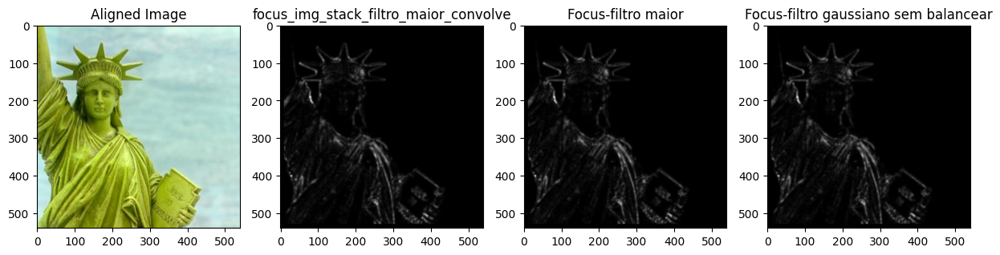

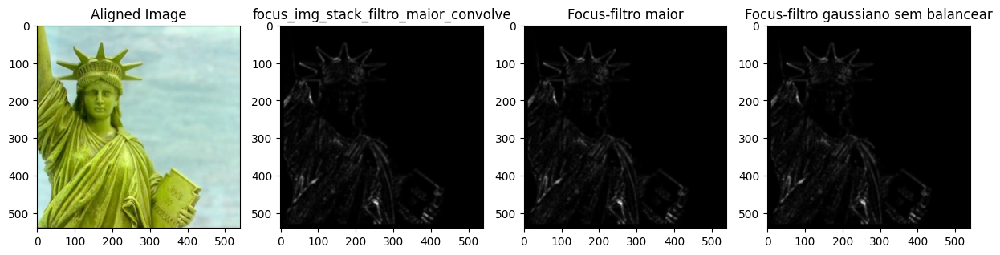

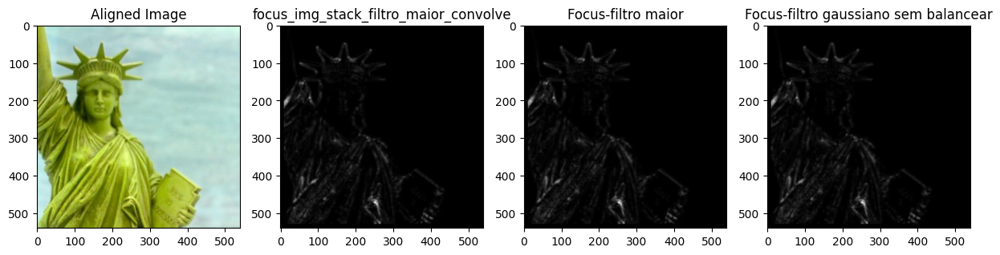

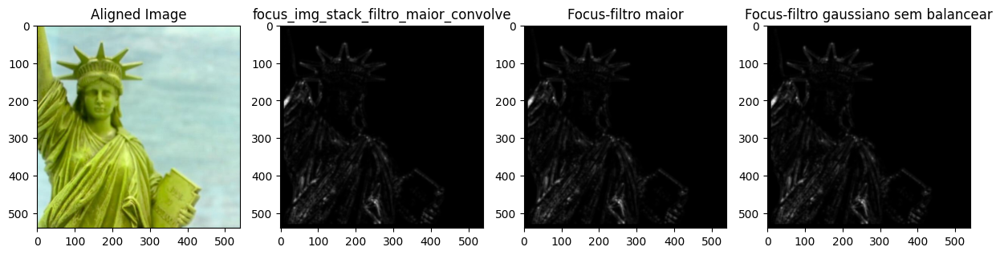

In [26]:
for i in range(aligned_img_stack.shape[0]):

    fig, axes = plt.subplots(1, 4, figsize=(15, 8))
    axes[0].imshow(aligned_img_stack[i])
    axes[0].set_title('Aligned Image')
    axes[1].imshow(focus_img_stack_filtro_maior_convolve[i], cmap='gray')
    axes[1].set_title('focus_img_stack_filtro_maior_convolve')
    axes[2].imshow(focus_img_stack_filtro_maior[i], cmap='gray')
    axes[2].set_title('Focus-filtro maior')
    axes[3].imshow(focus_img_stack_filtro_maior_sem_balancear[i], cmap='gray')
    axes[3].set_title('Focus-filtro gaussiano sem balancear')
    plt.show()

## Teste 4: Aplicando filtro de outlier

In [35]:

quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    #kernel = [[1,2,1], [2,4,2], [1,2,1]]
    #imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Aplica um filtro de borramento utilizando a média ponderada
    #imagem_final = convolve(imagem_final, WEIGHTS / np.sum(WEIGHTS))
    #imagem_final = cv2.filter2D(imagem_final, -1, WEIGHTS)

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

#fi_stack = fi_stack/ max_val
    
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator after normalization(fourier) max_val: {max_val}, min_val: {min_val}')


focus_img_stack_sem_normalização = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.012026, mean:0.000237, rms:0.000606, v_dev:0.000558
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.003635, mean:0.000044, rms:0.000103, v_dev:0.000093
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

In [39]:

quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    #kernel = [[1,2,1], [2,4,2], [1,2,1]]
    #imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Aplica um filtro de borramento utilizando a média ponderada
    #imagem_final = convolve(imagem_final, WEIGHTS / np.sum(WEIGHTS))
    #imagem_final = cv2.filter2D(imagem_final, -1, WEIGHTS)

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

#fi_stack = fi_stack/ max_val
# Remove outliers by clipping the values to the 1st and 99th percentiles
p1, p99 = np.percentile(fi_stack, [1, 99])
fi_stack = np.clip(fi_stack, p1, p99)

# Normalize the stack
fi_stack = (fi_stack - np.min(fi_stack)) / (np.max(fi_stack) - np.min(fi_stack))


focus_img_stack_normalizado_sem_outliers = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.012026, mean:0.000237, rms:0.000606, v_dev:0.000558
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.003635, mean:0.000044, rms:0.000103, v_dev:0.000093
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

In [40]:

quadrado = True
    
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):

    # 1. Converte a imagem para escala de cinza
    img_gray =  convert_img_to_grayscale(aligned_img).astype(np.float64)
    img_gray = img_gray/255

    # 2. Aplica a Transformada de Fourier 2D
    f_transformada = np.fft.fft2(img_gray)

    # 3. Desloca o zero da frequência para o centro
    f_centralizado = np.fft.fftshift(f_transformada)

    # 4. Cria um filtro passa-alta para manter apenas frequências altas
    linhas, colunas = img_gray.shape
    # raio = min(linhas, colunas) // 10  # Ajusta o raio para capturar alta frequência
        
    #mascara = np.ones((linhas, colunas), dtype=np.uint8)
    #cv2.circle(mascara, (colunas // 2, linhas // 2), raio, 0, -1)
    raio = 0.1
    mascara = mascara_eliptica_gaussiana(linhas, colunas, raio)
    #mascara = mascara_eliptica_binaria(linhas, colunas, raio)

    # 5. Aplica a máscara no domínio da frequência
    f_centralizado_filtrado = f_centralizado * mascara

    # 6. Desfaz a centralização e aplica a Transformada Inversa
    f_inversa = np.fft.ifftshift(f_centralizado_filtrado)
    imagem_reconstruida = np.fft.ifft2(f_inversa)

    imagem_reconstruida = np.real(imagem_reconstruida)

    print_img_statistics('fourier: img_reconstruida', imagem_reconstruida)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_reconstruida_{i}.png', imagem_reconstruida, np.min(imagem_reconstruida), np.max(imagem_reconstruida))

        
    # 7. Calcula o módulo ao quadrado da imagem reconstruída
    if quadrado:
        imagem_final = imagem_reconstruida ** 2
            
    else:    
        imagem_final = imagem_reconstruida

    print_img_statistics('fourier: img_final', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))

    # 8. Aplica um borramento de 3x3                
    #kernel = [[1,2,1], [2,4,2], [1,2,1]]
    #imagem_final = convolve(imagem_final, kernel)
    # imagem_final = mediana_ponderada()

    # Aplica um filtro de borramento utilizando a média ponderada
    #imagem_final = convolve(imagem_final, WEIGHTS / np.sum(WEIGHTS))
    imagem_final = cv2.filter2D(imagem_final, -1, WEIGHTS)

    # Zera as bordas da imagem
    imagem_final = zero_borders(imagem_final, 10)
    print_img_statistics('fourier: img convolucionada', imagem_final)
    #save_image('/home/lelis/Documents/Projetos/Stereo_Multifocus/depth_from_focus/data/synthetic/scene_3/organized_files/output/fourier/', f'fourier_img_final_convolucionada_{i}.png', imagem_reconstruida, 0, np.max(imagem_reconstruida))
    fi_stack.append(imagem_final)

fi_stack = np.array(fi_stack)
    
#fi_stack = abs(fi_stack)

min_val = np.min(fi_stack)
max_val = np.max(fi_stack)
print(f'focus indicator before normalization(fourier) max_val: {max_val}, min_val: {min_val}')

#fi_stack = fi_stack/ max_val
# Remove outliers by clipping the values to the 1st and 99th percentiles
p1, p99 = np.percentile(fi_stack, [1, 99])
fi_stack = np.clip(fi_stack, p1, p99)

# Normalize the stack
fi_stack = (fi_stack - np.min(fi_stack)) / (np.max(fi_stack) - np.min(fi_stack))


focus_img_stack_normalizado_sem_outliers_com_filtro_de_media = fi_stack

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.330103, mean:0.019224, rms:0.032979, v_dev:0.026797
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.128459, mean:0.003566, rms:0.005991, v_dev:0.004814
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

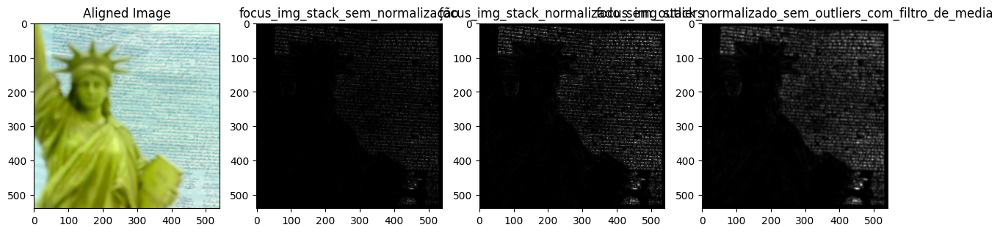

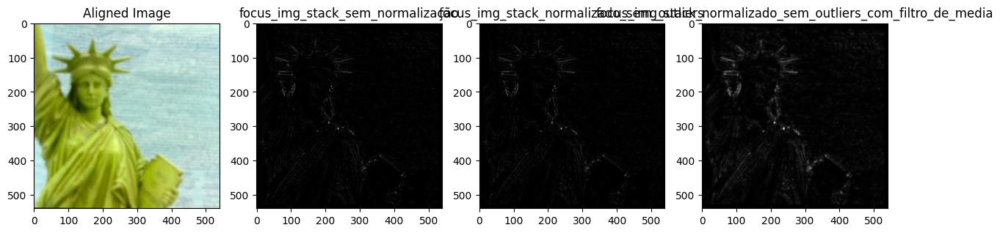

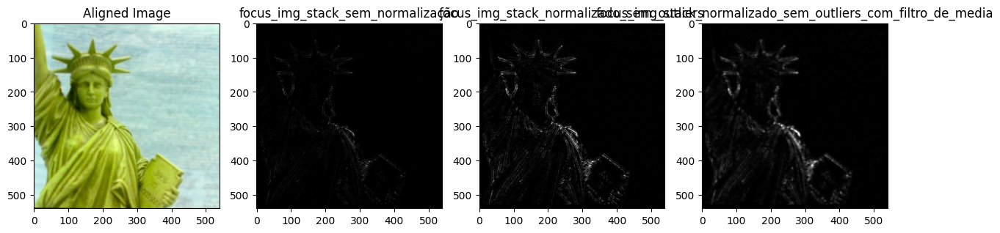

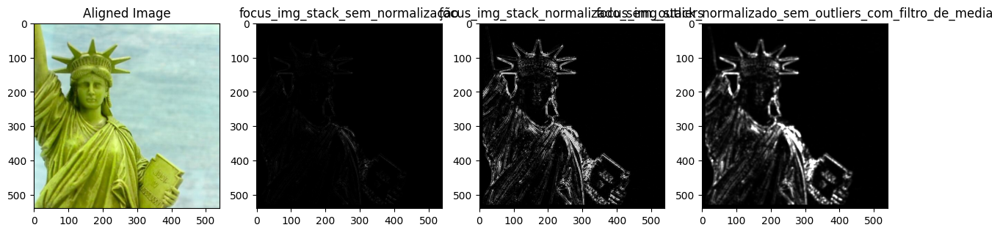

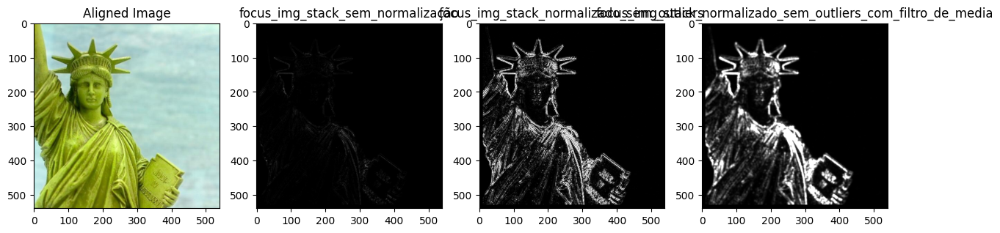

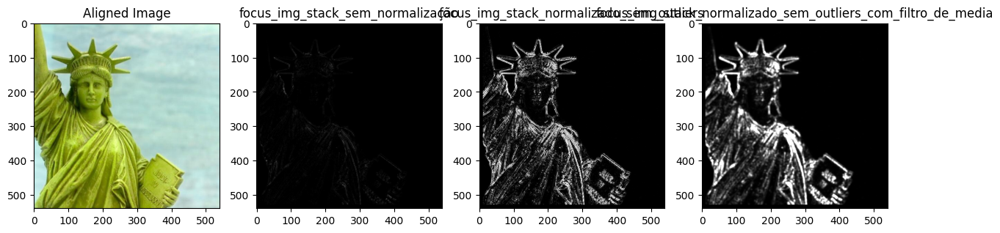

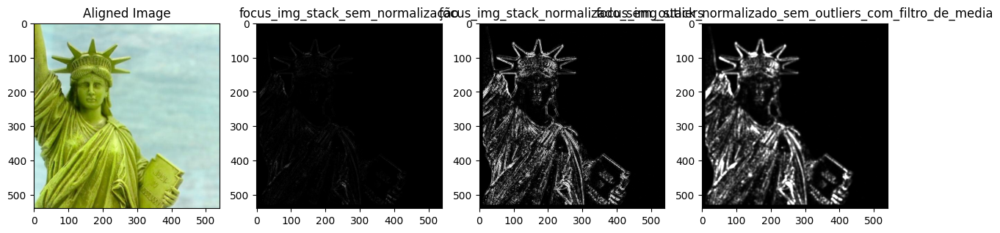

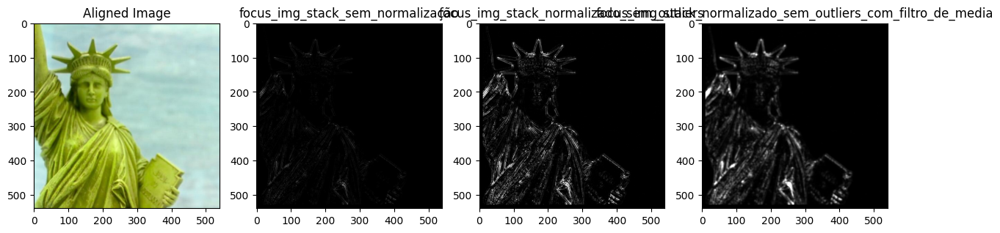

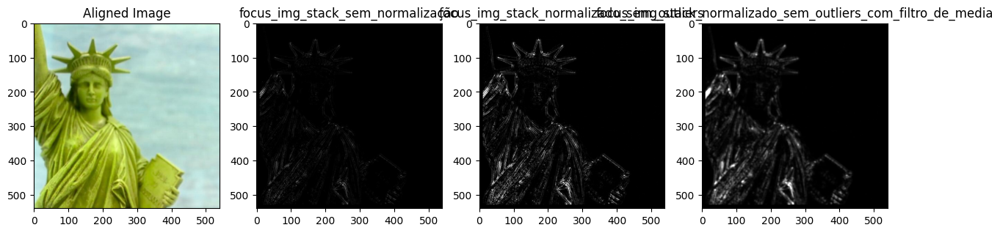

In [41]:
for i in range(aligned_img_stack.shape[0]):

    fig, axes = plt.subplots(1, 4, figsize=(15, 8))
    axes[0].imshow(aligned_img_stack[i])
    axes[0].set_title('Aligned Image')
    axes[1].imshow(focus_img_stack_sem_normalização[i], cmap='gray')
    axes[1].set_title('focus_img_stack_sem_normalização')
    axes[2].imshow(focus_img_stack_normalizado_sem_outliers[i], cmap='gray')
    axes[2].set_title('focus_img_stack_normalizado_sem_outliers')
    axes[3].imshow(focus_img_stack_normalizado_sem_outliers_com_filtro_de_media[i], cmap='gray')
    axes[3].set_title('focus_img_stack_normalizado_sem_outliers_com_filtro_de_media')
    plt.show()

# Laplacian

## Teste 5: Aplicando filtros de outlier

In [15]:
focus_stack_laplacian = focus_indicator_laplacian(aligned_img_stack, laplacian_kernel_size=3)

focus indicator before normalization (laplacian) max_val: 48.071111111111115, min_val: 0.0


In [72]:
    
laplacian_kernel_size = 3
fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):
    img_gray = convert_img_to_grayscale(aligned_img)
    img_gray = img_gray/255

    laplacian_img = cv2.Laplacian(img_gray, cv2.CV_64F, ksize=laplacian_kernel_size)

        
    #laplacian_img = zero_borders(laplacian_img, 2*laplacian_kernel_size+1)
    laplacian_img = laplacian_img **2
    laplacian_img = abs(laplacian_img)
    fi_stack.append(laplacian_img)

fi_stack = np.array(fi_stack)
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)

# Remove outliers by clipping the values to the 1st and 99th percentiles
p1, p99 = np.percentile(fi_stack, [1, 99])
fi_stack = np.clip(fi_stack, p1, p99)

print(f'focus indicator before normalization (laplacian) max_val: {max_val}, min_val: {min_val}')
fi_stack = fi_stack/ max_val

focus_stack_laplacian_sem_outliers = fi_stack

focus indicator before normalization (laplacian) max_val: 48.071111111111115, min_val: 0.0


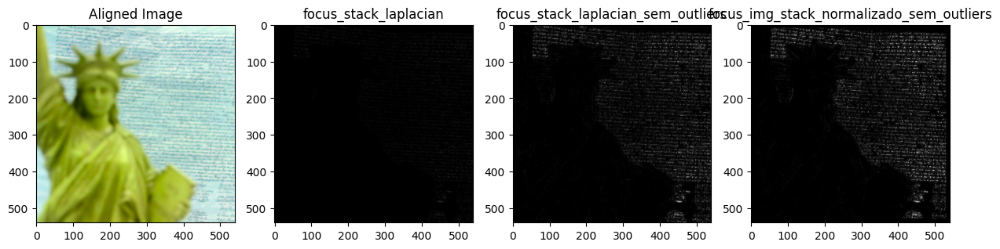

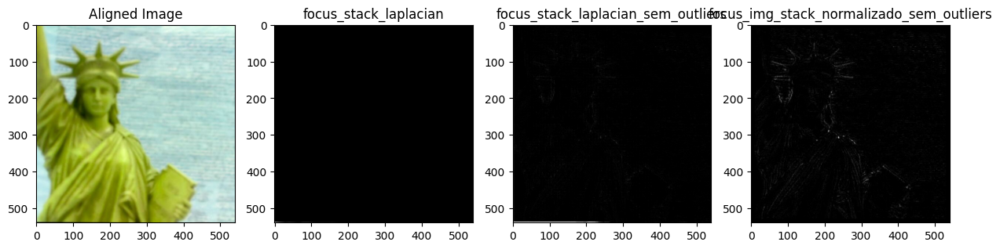

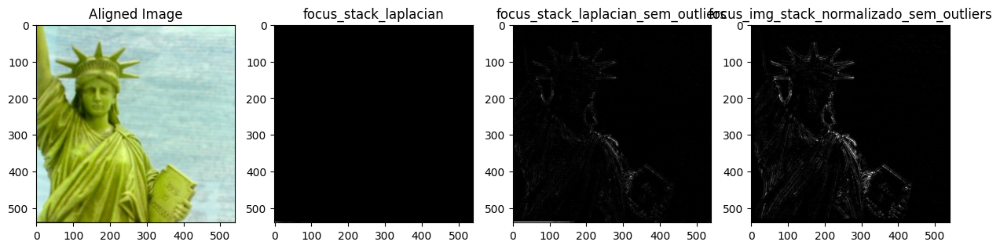

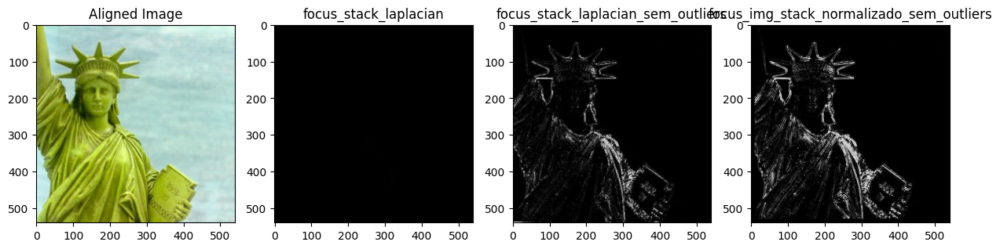

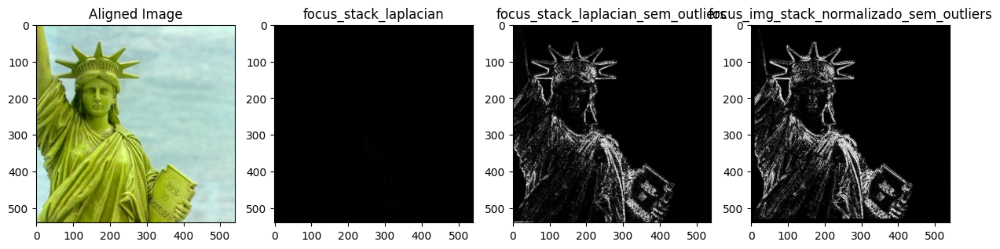

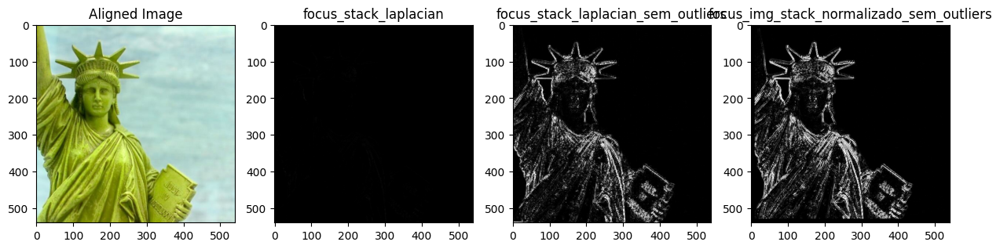

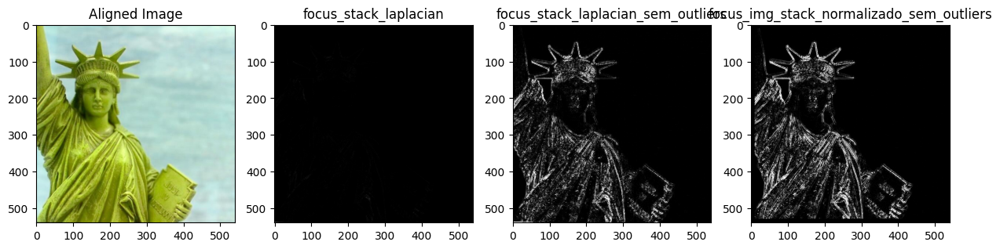

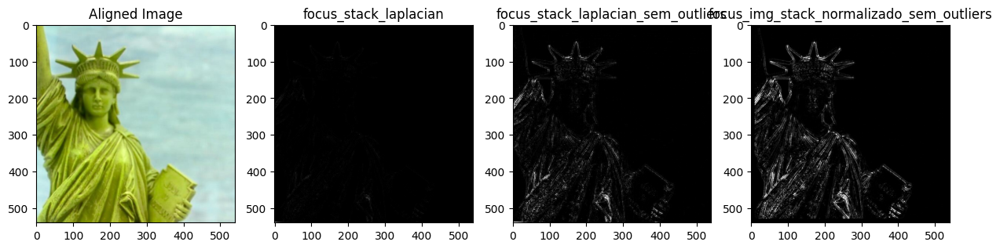

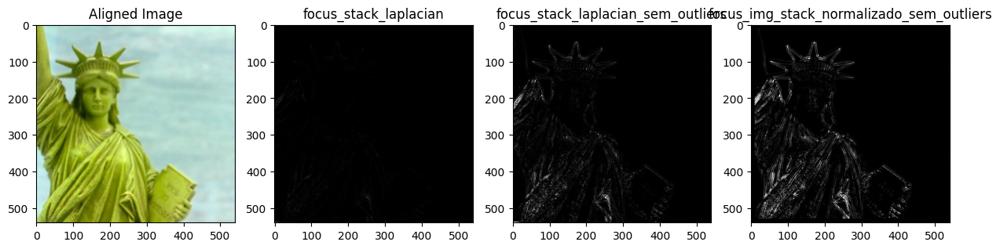

In [73]:
for i in range(aligned_img_stack.shape[0]):

    fig, axes = plt.subplots(1, 4, figsize=(15, 8))
    axes[0].imshow(aligned_img_stack[i])
    axes[0].set_title('Aligned Image')
    axes[1].imshow(focus_stack_laplacian[i], cmap='gray')
    axes[1].set_title('focus_stack_laplacian')
    axes[2].imshow(focus_stack_laplacian_sem_outliers[i], cmap='gray')
    axes[2].set_title('focus_stack_laplacian_sem_outliers')
    axes[3].imshow(focus_img_stack_normalizado_sem_outliers[i], cmap='gray')
    axes[3].set_title('focus_img_stack_normalizado_sem_outliers')

    plt.show()

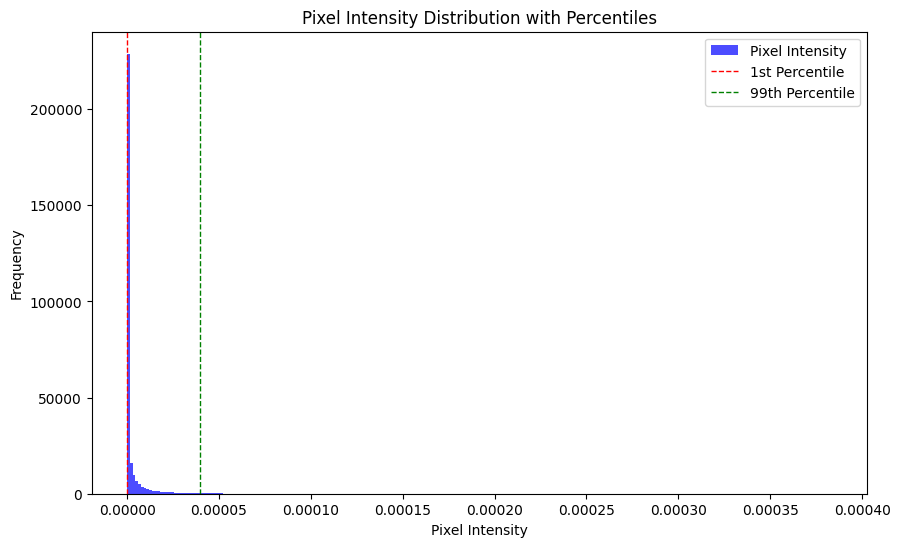

Mean: 2.472413928913783e-06
Standard Deviation: 8.081298962523633e-06
Median: 3.813714881699885e-08
Min Value: 0.0
Max Value: 0.0003834589285878139
1st Percentile: 0.0
99th Percentile: 3.975493946687913e-05


In [71]:
import matplotlib.pyplot as plt

# Seleciona uma imagem do stack
img_gray = focus_img_stack_sem_normalização[5]

# Converte a imagem para escala de cinza
#img_gray = convert_img_to_grayscale(img).astype(np.float64)

img_gray = img_gray / 255

# Calcula o percentil 1 e 99
p1, p99 = np.percentile(img_gray, [1, 99])

# Plota o histograma da imagem
plt.figure(figsize=(10, 6))
plt.hist(img_gray.ravel(), bins=256, color='blue', alpha=0.7, label='Pixel Intensity')

# Adiciona linhas verticais para os percentis
plt.axvline(p1, color='red', linestyle='dashed', linewidth=1, label='1st Percentile')
plt.axvline(p99, color='green', linestyle='dashed', linewidth=1, label='99th Percentile')

# Adiciona título e legendas
plt.title('Pixel Intensity Distribution with Percentiles')
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend()

# Mostra o gráfico
plt.show()

# Calcula e imprime estatísticas adicionais
mean = np.mean(img_gray)
std_dev = np.std(img_gray)
median = np.median(img_gray)
min_val = np.min(img_gray)
max_val = np.max(img_gray)

print(f'Mean: {mean}')
print(f'Standard Deviation: {std_dev}')
print(f'Median: {median}')
print(f'Min Value: {min_val}')
print(f'Max Value: {max_val}')
print(f'1st Percentile: {p1}')
print(f'99th Percentile: {p99}')




In [63]:
512*512

262144

In [75]:
from normalizador_defoco_por_pixel import *

In [16]:
focus_stack_laplacian_normalizado_por_pixel = normaliza_indicador_de_foco_por_pixel(focus_stack_laplacian)

In [12]:
focus_stack_fourier = focus_indicator_fourier(aligned_img_stack)

nome:fourier: img_reconstruida, shape:(540, 540), min:-0.267395, max:0.256046, mean:-0.000000, rms:0.020061, v_dev:0.020061
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.071500, mean:0.000402, rms:0.002009, v_dev:0.001969
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.106239, mean:0.003797, rms:0.007648, v_dev:0.006639
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.555058, max:0.284605, mean:0.000000, rms:0.022472, v_dev:0.022472
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.308090, mean:0.000505, rms:0.007061, v_dev:0.007042
nome:fourier: img convolucionada, shape:(540, 540), min:0.000000, max:0.043250, mean:0.000704, rms:0.001385, v_dev:0.001193
nome:fourier: img_reconstruida, shape:(540, 540), min:-0.550596, max:0.276211, mean:-0.000000, rms:0.017924, v_dev:0.017924
nome:fourier: img_final, shape:(540, 540), min:0.000000, max:0.303156, mean:0.000321, rms:0.002869, v_dev:0.002851
nome:fourier: img convolucionada, sh

In [13]:
focus_stack_fourier_normalizado_por_pixel = normaliza_indicador_de_foco_por_pixel(focus_stack_fourier)

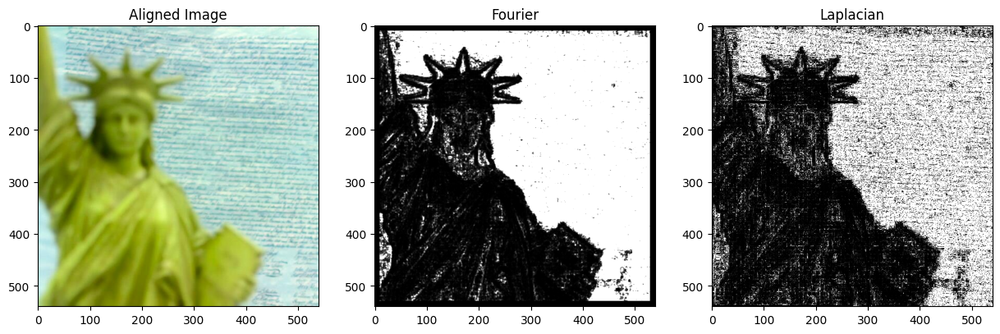

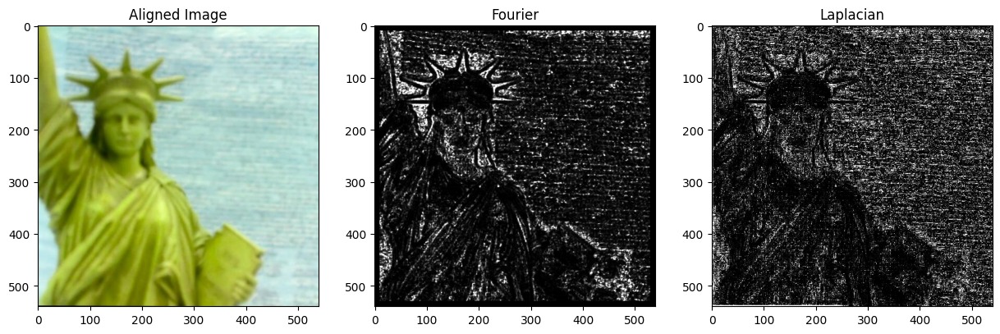

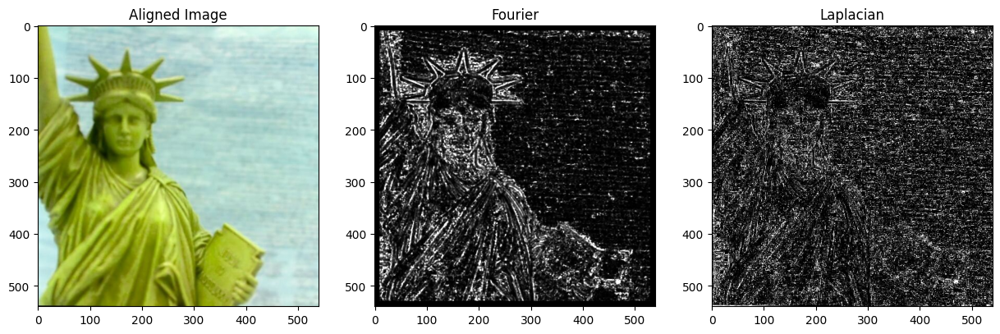

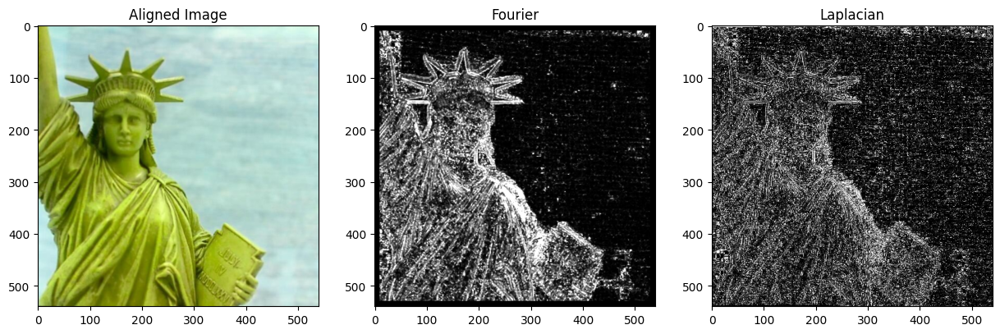

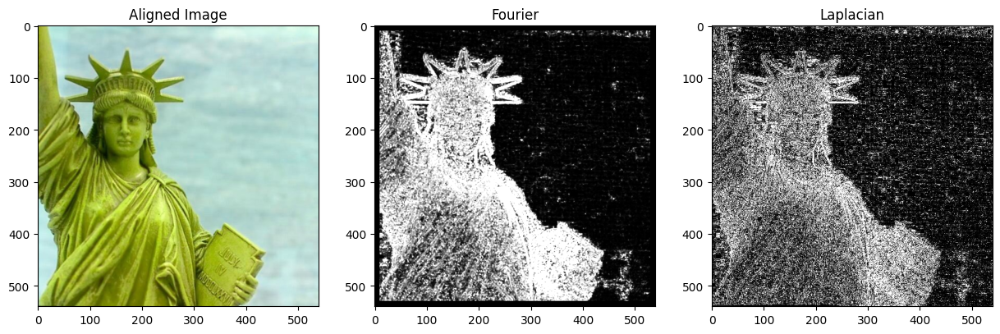

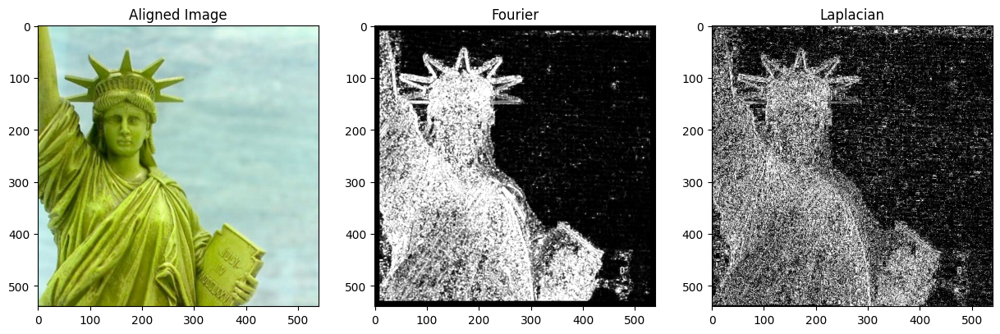

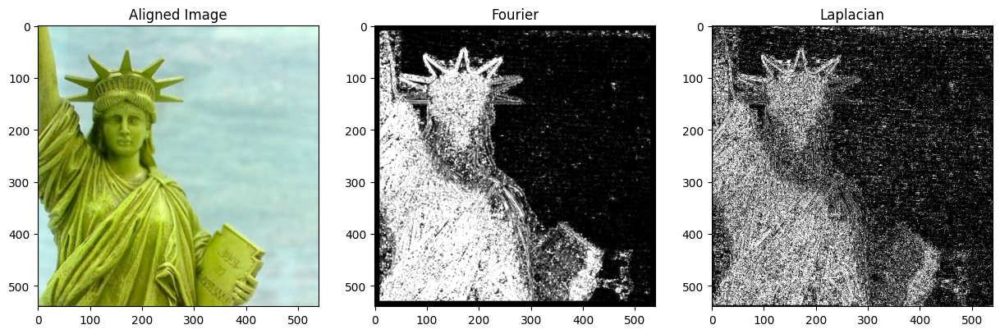

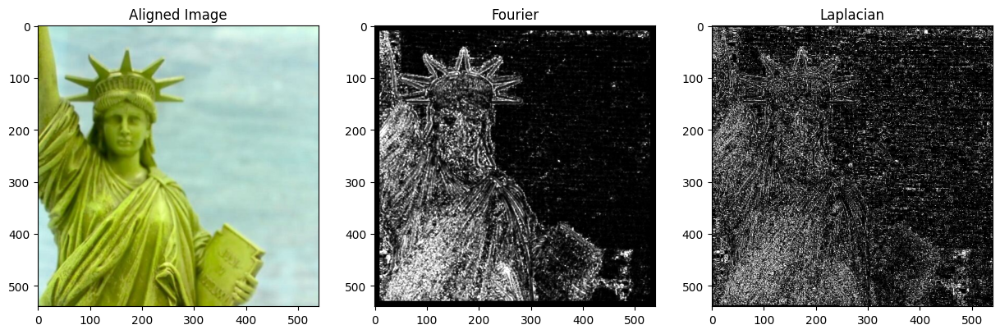

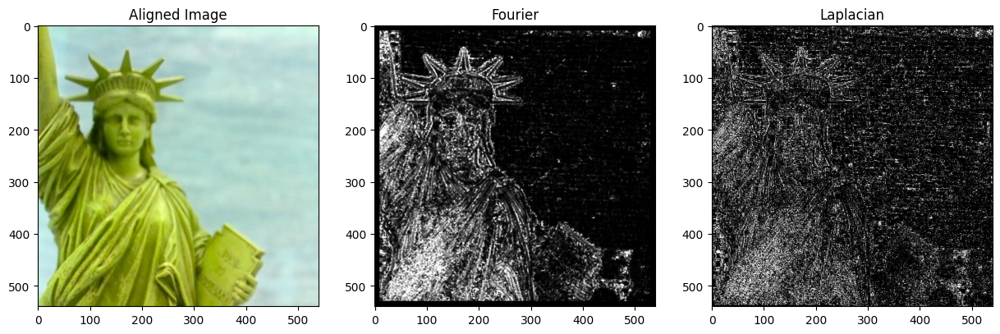

In [84]:
for i in range(aligned_img_stack.shape[0]):

    fig, axes = plt.subplots(1, 3, figsize=(15, 8))
    axes[0].imshow(aligned_img_stack[i])
    axes[0].set_title('Aligned Image')
    axes[1].imshow(focus_stack_fourier_normalizado_por_pixel[i],cmap='gray')
    axes[1].set_title('Fourier')
    axes[2].imshow(focus_stack_laplacian_normalizado_por_pixel[i],cmap='gray')
    axes[2].set_title('Laplacian')

    plt.show()

# Indicador de foco por residuo não linear

In [6]:

fi_stack = []

for i, aligned_img in enumerate(aligned_img_stack):
    img_gray = convert_img_to_grayscale(aligned_img)
    img_gray = img_gray/255

    indicator_img = calcular_indicador_foco(img_gray)
    fi_stack.append(indicator_img)

fi_stack = np.array(fi_stack)
min_val = np.min(fi_stack)
max_val = np.max(fi_stack)

# Remove outliers by clipping the values to the 1st and 99th percentiles
#p1, p99 = np.percentile(fi_stack, [1, 99])
#fi_stack = np.clip(fi_stack, p1, p99)

print(f'focus indicator before normalization / max_val: {max_val}, min_val: {min_val}')
fi_stack = fi_stack/ max_val

focus_stack_res_non_lienar = fi_stack

focus indicator before normalization / max_val: 0.8552393428928096, min_val: 0.0


In [9]:
focus_stack_res_non_lienar_normalizado_por_pixel = normaliza_indicador_de_foco_por_pixel(focus_stack_res_non_lienar)

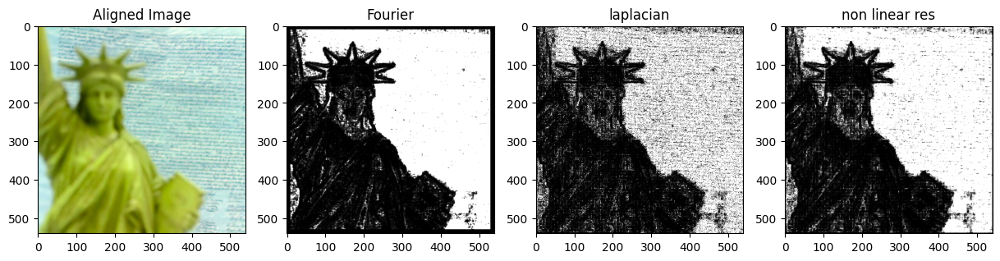

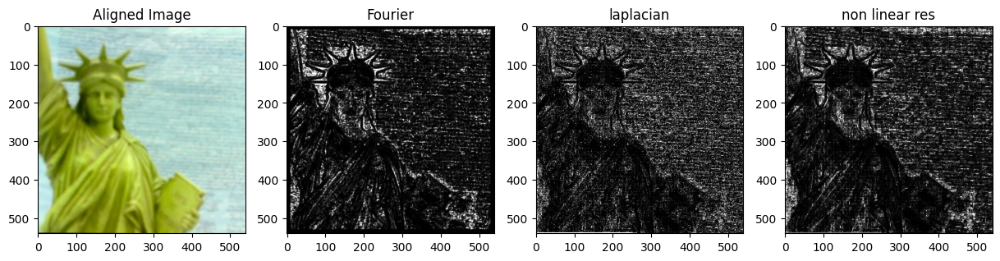

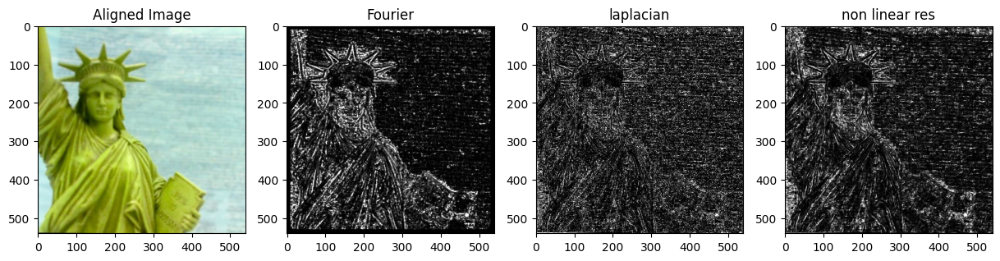

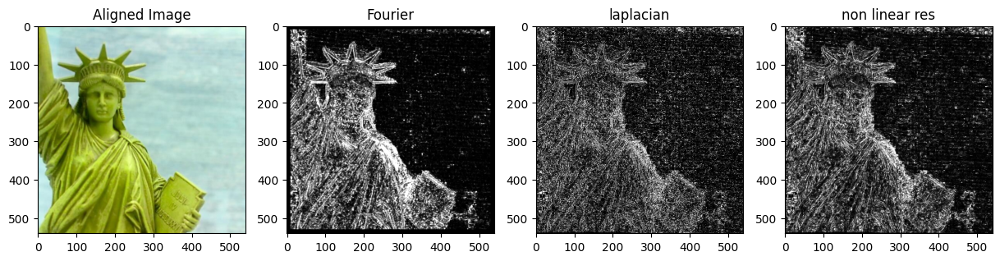

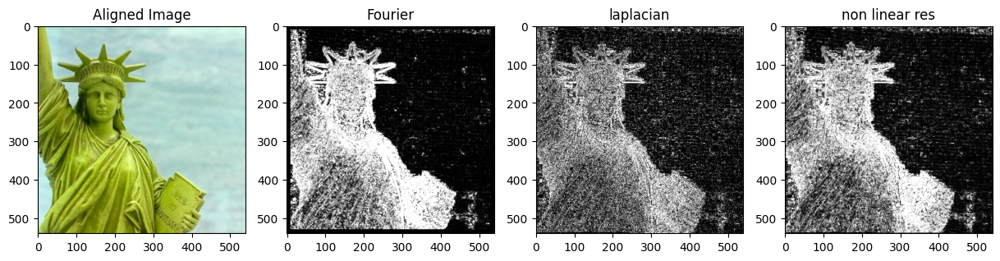

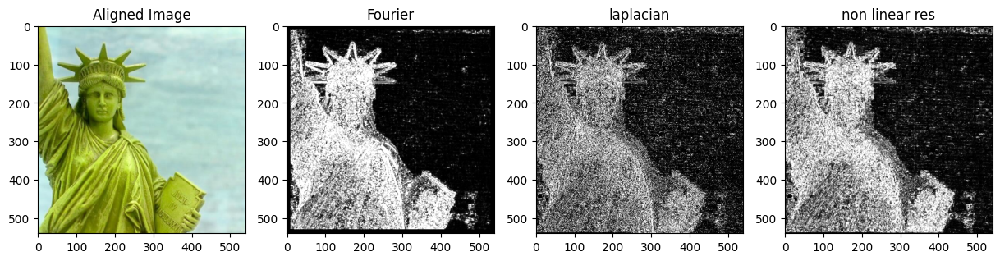

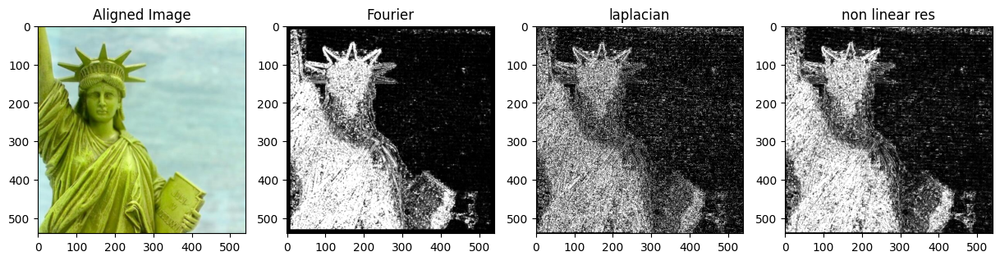

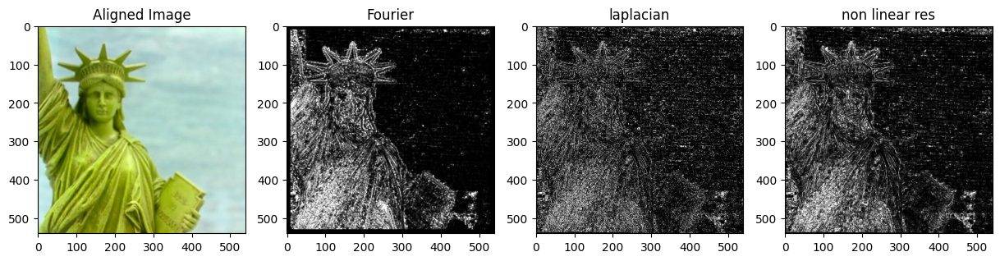

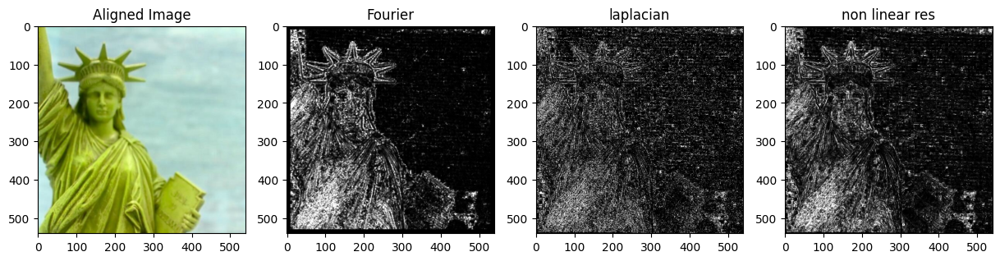

In [17]:
for i in range(aligned_img_stack.shape[0]):

    fig, axes = plt.subplots(1, 4, figsize=(15, 8))
    axes[0].imshow(aligned_img_stack[i])
    axes[0].set_title('Aligned Image')
    axes[1].imshow(focus_stack_fourier_normalizado_por_pixel[i],cmap='gray')
    axes[1].set_title('Fourier')
    axes[2].imshow(focus_stack_laplacian_normalizado_por_pixel[i],cmap='gray')
    axes[2].set_title('laplacian')
    axes[3].imshow(focus_stack_res_non_lienar_normalizado_por_pixel[i],cmap='gray')
    axes[3].set_title('non linear res')


    plt.show()